In [1]:
# Change image size limit before import opencv
import os
os.environ["OPENCV_IO_MAX_IMAGE_PIXELS"] = pow(2,40).__str__()

import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import os
from skimage import io
from tqdm import tqdm

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
df_train = pd.read_csv('/kaggle/input/UBC-OCEAN/train.csv')
df_train

,image_id,label,image_width,image_height,is_tma
0,4,HGSC,23785,20008,False
1,66,LGSC,48871,48195,False
2,91,HGSC,3388,3388,True
3,281,LGSC,42309,15545,False
4,286,EC,37204,30020,False
...,...,...,...,...,...
533,65022,LGSC,53355,46675,False
534,65094,MC,55042,45080,False
535,65300,HGSC,75860,27503,False
536,65371,HGSC,42551,41800,False


<Axes: xlabel='image_width', ylabel='image_height'>

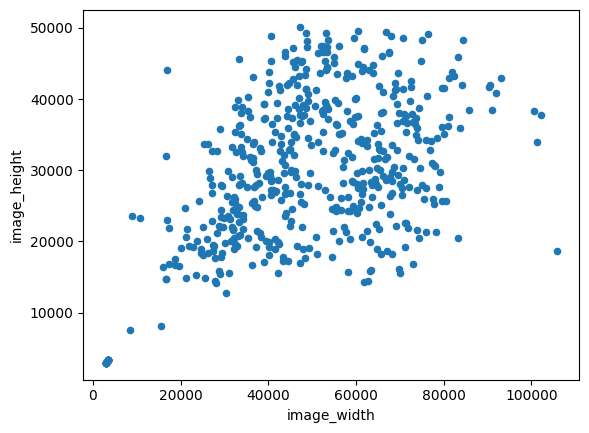

In [3]:
df_train.plot.scatter(x='image_width', y='image_height')

In [4]:
df_train[['image_width', 'image_height']].min()

image_width     2964
image_height    2964
dtype: int64

In [5]:
df_train[df_train['image_width']==2964]

,image_id,label,image_width,image_height,is_tma
37,4134,MC,2964,2964,True
76,8280,HGSC,2964,2964,True
112,13568,LGSC,2964,2964,True
149,17637,HGSC,2964,2964,True
288,35565,MC,2964,2964,True
305,36783,MC,2964,2964,True
350,40864,LGSC,2964,2964,True
355,41586,CC,2964,2964,True
361,42857,CC,2964,2964,True
399,47035,EC,2964,2964,True


In [6]:
# Config
size = (2964, 2964)

In [7]:
# save folder
os.mkdir('/kaggle/working/reduced/')

for image_id in tqdm(df_train['image_id'].to_list()):
    # Background
    base_pic=np.zeros((size[1],size[0],3),np.uint8)
    
    # Read the original image if there is no thumbnail.
    pic = f'/kaggle/input/UBC-OCEAN/train_thumbnails/{image_id}_thumbnail.png'
    if ~os.path.isfile(pic):
        pic = f'/kaggle/input/UBC-OCEAN/train_images/{image_id}.png'
    pic1=cv2.imread(pic,cv2.IMREAD_COLOR)
    h,w=pic1.shape[:2]
    ash=size[1]/h
    asw=size[0]/w
    if asw<ash:
        sizeas=(int(w*asw),int(h*asw))
    else:
        sizeas=(int(w*ash),int(h*ash))
    pic1 = cv2.resize(pic1,dsize=sizeas)
    base_pic[int(size[1]/2-sizeas[1]/2):int(size[1]/2+sizeas[1]/2),
    int(size[0]/2-sizeas[0]/2):int(size[0]/2+sizeas[0]/2),:]=pic1
    cv2.imwrite(f'reduced/{image_id}.png', base_pic)

100%|██████████| 538/538 [7:48:59<00:00, 52.30s/it]   


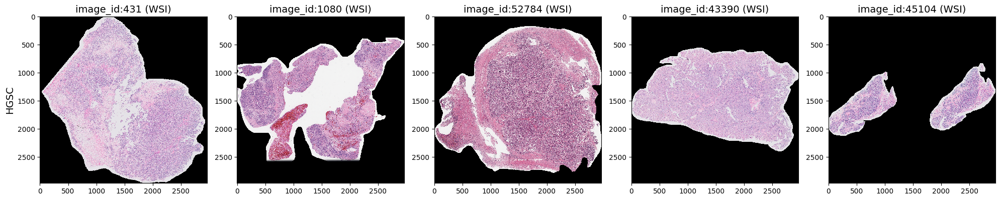

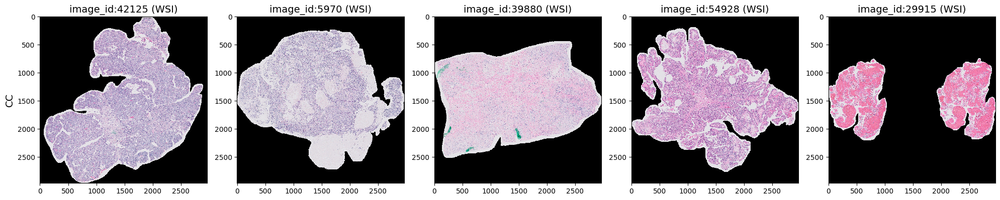

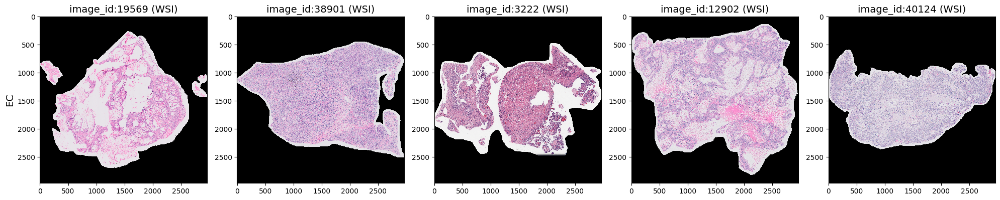

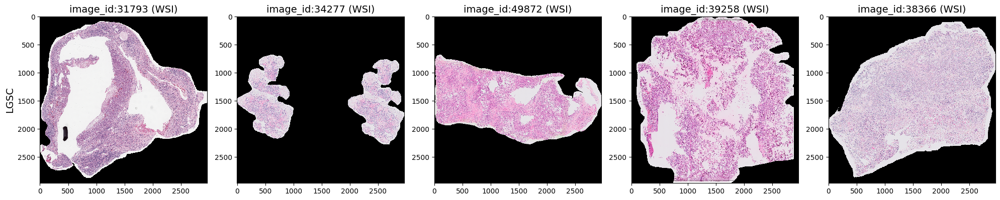

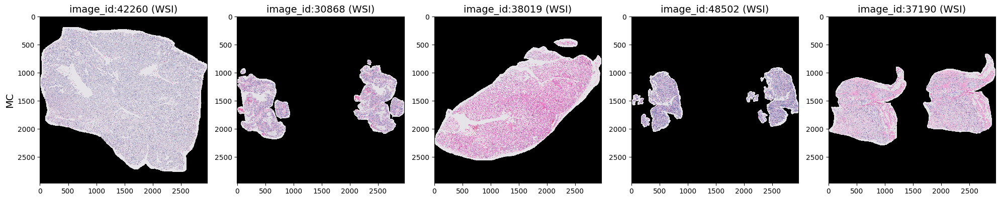

In [8]:
# Sample Visualization
for label in ['HGSC', 'CC', 'EC', 'LGSC', 'MC']:
    df_tmp = df_train[df_train['label']==label]
    image_id_list = list(df_tmp[~df_tmp['is_tma']]['image_id'].sample(5))
    plt.figure(figsize=(20.0, 6.0))
    for i in range(len(image_id_list)):
        image_id = image_id_list[i]
        plt.subplot(1, 5, i+1)
        if i == 0:
            plt.title(f'image_id:{image_id} (WSI)', fontsize=14)
            plt.ylabel(label, fontsize=14)
        else:
            plt.title(f'image_id:{image_id} (WSI)', fontsize=14)
            
        io.imshow(f'reduced/{image_id}.png')
        #plt.tick_params(labelbottom=False, labelleft=False, labelright=False, labeltop=False, bottom=False, left=False, right=False, top=False)
    plt.show()

In [9]:
import os

import numpy as np
import pandas as pd
import shutil

from matplotlib import pyplot as plt
import PIL
from PIL import Image
from tqdm import tqdm

from sklearn.metrics import confusion_matrix, balanced_accuracy_score, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import backend as K
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras import layers
from tensorflow.keras.applications import EfficientNetV2S
from tensorflow.keras.preprocessing.image import load_img, img_to_array

PIL.Image.MAX_IMAGE_PIXELS = 9331200000000

In [10]:
tf.__version__

'2.13.0'

In [11]:
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver.connect()
    print("Device:", tpu.master())
    strategy = tf.distribute.TPUStrategy(tpu)
except ValueError:
    print("Not connected to a TPU runtime. Using CPU/GPU strategy")
    strategy = tf.distribute.MirroredStrategy()

Not connected to a TPU runtime. Using CPU/GPU strategy


In [12]:
# Copying train_meta data into other data folder

PATH_DIR_2964_PNG = '/kaggle/working/reduced'
PATH_DIR = '/kaggle/input/UBC-OCEAN'

IMG_SIZE = 600
NUM_CLASSES = 5

batch_size = 8

In [13]:
train_df = pd.read_csv(os.path.join(PATH_DIR, 'train.csv'))
test_df = pd.read_csv(os.path.join(PATH_DIR, 'test.csv'))

In [14]:
train_df.shape, test_df.shape

((538, 5), (1, 3))

In [15]:
train_df.head()

,image_id,label,image_width,image_height,is_tma
0,4,HGSC,23785,20008,False
1,66,LGSC,48871,48195,False
2,91,HGSC,3388,3388,True
3,281,LGSC,42309,15545,False
4,286,EC,37204,30020,False


In [16]:
print("Total Number Of Unique Images In Training: ", train_df['image_id'].nunique())

Total Number Of Unique Images In Training:  538


In [17]:
encode = {lbl: idx for idx, lbl in enumerate(train_df.label.unique())}
encode

{'HGSC': 0, 'LGSC': 1, 'EC': 2, 'CC': 3, 'MC': 4}

In [18]:
decode = {lbl: idx for idx, lbl in encode.items()}
decode

{0: 'HGSC', 1: 'LGSC', 2: 'EC', 3: 'CC', 4: 'MC'}

In [19]:
# def get_file_path(image_id):
#     if os.path.exists(f"{PATH_DIR}/train_thumbnails/{image_id}_thumbnail.png"):
#         return f"{PATH_DIR}/train_thumbnails/{image_id}_thumbnail.png"
#     else:
#         return f"{PATH_DIR}/train_images/{image_id}.png"

def get_file_path(image_id):
    return f"{PATH_DIR_2964_PNG}/{image_id}.png"
    

train_df['file_path'] = train_df['image_id'].apply(get_file_path)
train_df['label_id'] = train_df['label'].map(encode)

train_df.head()

,image_id,label,image_width,image_height,is_tma,file_path,label_id
0,4,HGSC,23785,20008,False,/kaggle/working/reduced/4.png,0
1,66,LGSC,48871,48195,False,/kaggle/working/reduced/66.png,1
2,91,HGSC,3388,3388,True,/kaggle/working/reduced/91.png,0
3,281,LGSC,42309,15545,False,/kaggle/working/reduced/281.png,1
4,286,EC,37204,30020,False,/kaggle/working/reduced/286.png,2


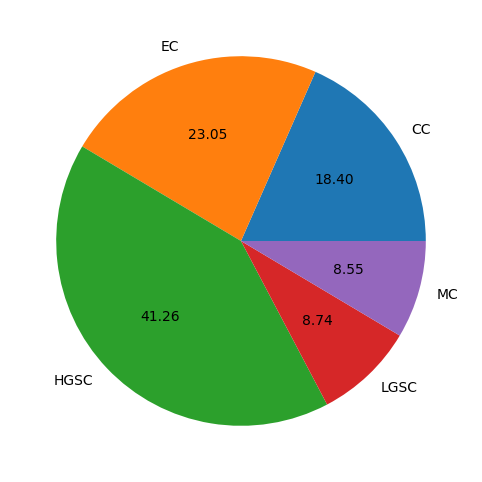

In [20]:
plt.figure(figsize=(10,6))

tmp = train_df.groupby(['label'])['image_id'].nunique().plot(kind='pie', autopct="%0.2f")
plt.gca().get_yaxis().set_visible(False)
plt.show()

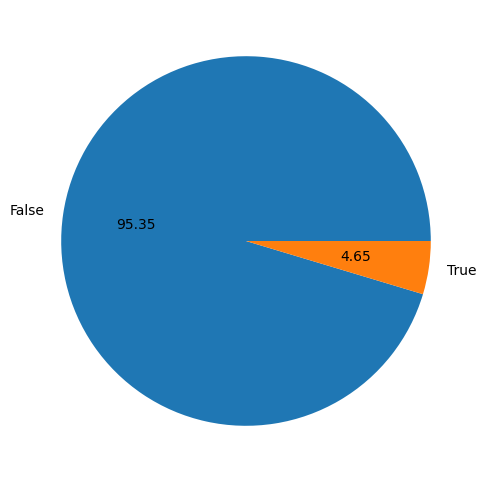

In [21]:
plt.figure(figsize=(10,6))
train_df.groupby('is_tma')['image_id'].nunique().plot(kind='pie', autopct="%0.2f")
plt.gca().get_yaxis().set_visible(False)
plt.show()

Image Size:  (3000, 2523)
Image Labels:  HGSC


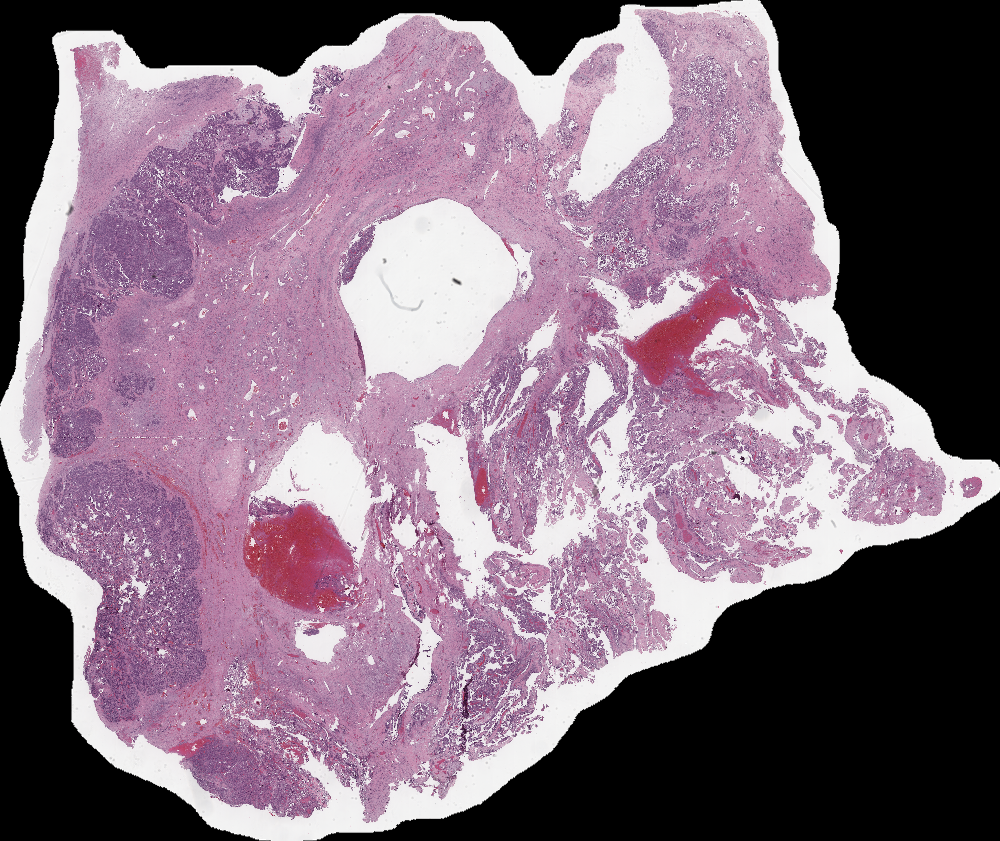

In [22]:
img = Image.open("/kaggle/input/UBC-OCEAN/train_thumbnails/4_thumbnail.png")
print("Image Size: ", img.size)
print("Image Labels: ", train_df.loc[train_df['image_id']== 4, 'label'].values[0])
img

In [23]:
# gkf  = GroupKFold(n_splits = 4)

# train_df['fold'] = -1

# for fold, (train_idx, val_idx) in enumerate(gkf.split(train_df, 
#                                                       groups = train_df.image_id.tolist())):
#     train_df.loc[val_idx, 'fold'] = fold
    
# train_df.head()

x_train, x_valid = train_test_split(train_df, 
                                    test_size=0.3,
                                    stratify=train_df['label'],
                                    random_state=143
                                   )
print(x_train.shape)
print(x_valid.shape)

(376, 7)
(162, 7)


/opt/conda/lib/python3.10/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/conda/lib/python3.10/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):


In [24]:
# train_files = []
# valid_files   = []
# valid_files += list(train_df[train_df.fold==1]['image_id'].unique())
# train_files += list(train_df[train_df.fold!=1]['image_id'].unique())

train_files = x_train['image_id'].unique().tolist()
valid_files = x_valid['image_id'].unique().tolist()

print("Training Images: ", len(train_files))
print("Validation Images: ", len(valid_files))

Training Images:  376
Validation Images:  162


In [25]:
## Validation that Validation images are not in training Files
(pd.Series(valid_files).isin(pd.Series(train_files))).sum()

0

In [26]:
def load_image(filename):
    img = load_img(filename, target_size=(IMG_SIZE, IMG_SIZE))
    img = img_to_array(img)
    return img

X_train = []
y_train = []

X_valid = []
y_valid = []

## Training 
for i in tqdm(range(len(train_files))):
    file_path = train_df.iloc[i]['file_path']
    label = train_df.iloc[i]['label_id']
    X_train.append(load_image(file_path))
    y_train.append(label)

# Convert the data to numpy arrays
X_train = np.array(X_train)
y_train = np.array(y_train)

# Print the shape of the data arrays
print('X_train shape:', X_train.shape)
print('y_train shape:', y_train.shape)


## Validation
for i in tqdm(range(len(valid_files))):
    file_path = train_df.iloc[i]['file_path']
    label = train_df.iloc[i]['label_id']
    X_valid.append(load_image(file_path))
    y_valid.append(label)

# Convert the data to numpy arrays
X_valid = np.array(X_valid)
y_valid = np.array(y_valid)

# Print the shape of the data arrays
print('X_valid shape:', X_valid.shape)
print('y_valid shape:', y_valid.shape)


# Converting into tensor flow dataset
ds_train = tf.data.Dataset.from_tensor_slices((X_train, y_train))
ds_valid = tf.data.Dataset.from_tensor_slices((X_valid, y_valid))

100%|██████████| 376/376 [01:24<00:00,  4.45it/s]


X_train shape: (376, 600, 600, 3)
y_train shape: (376,)


100%|██████████| 162/162 [00:30<00:00,  5.32it/s]


X_valid shape: (162, 600, 600, 3)
y_valid shape: (162,)


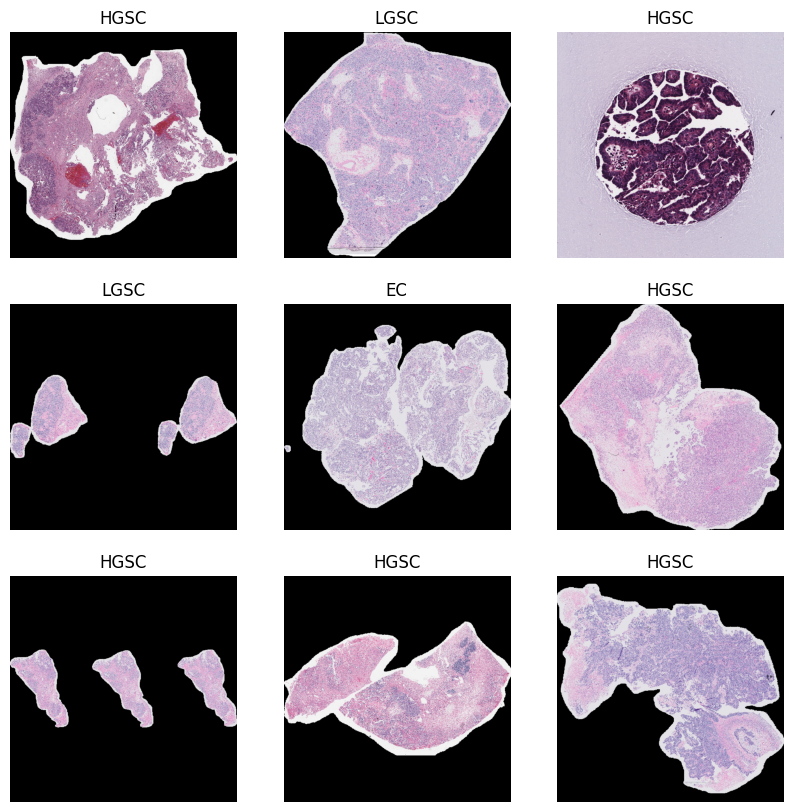

In [27]:
plt.figure(figsize=(10,10))

for i, (image, label) in enumerate(ds_train.take(9)):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(image.numpy().astype("uint16"))
    plt.title("{}".format(decode[label.numpy()]))
    plt.axis("off")

plt.show()

In [28]:
img_augmentation = Sequential(
    [
        layers.RandomRotation(factor=0.15),
        layers.RandomTranslation(height_factor=0.1, width_factor=0.1),
        layers.RandomFlip(),
        layers.RandomContrast(factor=0.1),
    ],
    name="img_augmentation",
)

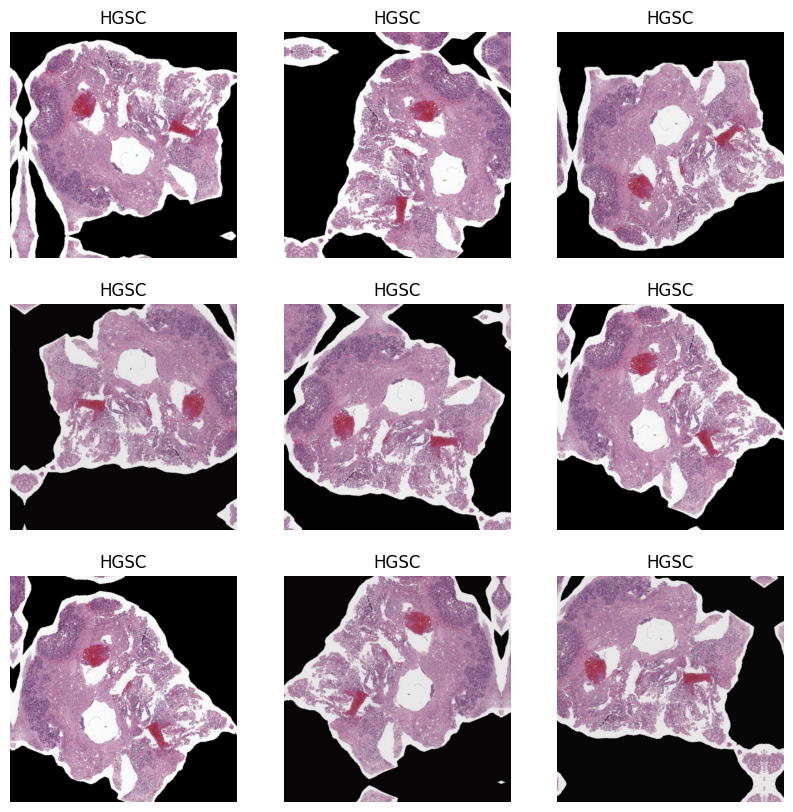

In [29]:
plt.figure(figsize=(10,10))

for image, label in ds_train.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        aug_img = img_augmentation(tf.expand_dims(image, axis=0))
        plt.imshow(aug_img[0].numpy().astype("uint8"))
        plt.title("{}".format(decode[label.numpy()]))
        plt.axis("off")
        
plt.show()

In [30]:
def input_preprocess(image, label):
    label = tf.one_hot(label, NUM_CLASSES)
    return image, label


ds_train = ds_train.map(
    input_preprocess, num_parallel_calls=tf.data.AUTOTUNE
)

ds_train = ds_train.batch(batch_size=batch_size)
ds_train = ds_train.prefetch(tf.data.AUTOTUNE)

ds_valid = ds_valid.map(input_preprocess)
ds_valid = ds_valid.batch(batch_size=batch_size)

In [31]:
def build_model(num_classes):
    
    inputs = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    x = img_augmentation(inputs)
    
    model = EfficientNetV2S(include_top=False, input_tensor=x, weights="imagenet")

    # Freeze the pretrained weights
    model.trainable = False
    
    no_of_layers = len(model.layers)
    no_of_layers_to_train = int(no_of_layers/2)
    
    for layer in model.layers[-no_of_layers_to_train:]:
        if not isinstance(layer, layers.BatchNormalization):
            layer.trainable = True

    # Rebuild top
    x = layers.GlobalAveragePooling2D(name="avg_pool")(model.output)
    x = layers.BatchNormalization()(x)

    top_dropout_rate = 0.2
    x = layers.Dropout(top_dropout_rate, name="top_dropout")(x)
    outputs = layers.Dense(num_classes, activation="softmax", name="pred")(x)

    # Compile
    model = tf.keras.Model(inputs, outputs, name="EfficientNet")
    
    
    optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)
    
    METRICS = [
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='prc', curve='PR')]
    
    model.compile(
        optimizer=optimizer,
        loss="categorical_crossentropy",
        metrics= [METRICS]
    )
    return model

In [32]:
def plot_hist(hist, monitor='loss'):
    plt.plot(hist.history[monitor])
    plt.plot(hist.history[f"val_{monitor}"])
    plt.title(f"model {monitor}")
    plt.ylabel(f"{monitor}")
    plt.xlabel("epoch")
    plt.legend(["train", "validation"], loc="upper left")
    plt.show()

82420632/82420632 [==============================] - 0s 0us/step
Epoch 1/50


2023-11-28 07:54:42.466576: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inEfficientNet/block1b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


47/47 [==============================] - ETA: 0s - loss: 2.1919 - recall: 0.1622 - prc: 0.2400

/opt/conda/lib/python3.10/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


47/47 [==============================] - 65s 499ms/step - loss: 2.1919 - recall: 0.1622 - prc: 0.2400 - val_loss: 1.3842 - val_recall: 0.0000e+00 - val_prc: 0.4357
Epoch 2/50
47/47 [==============================] - 15s 320ms/step - loss: 1.8467 - recall: 0.2074 - prc: 0.3048 - val_loss: 1.4369 - val_recall: 0.0000e+00 - val_prc: 0.5069
Epoch 3/50
47/47 [==============================] - 17s 366ms/step - loss: 1.5828 - recall: 0.2819 - prc: 0.4016 - val_loss: 1.3786 - val_recall: 0.0000e+00 - val_prc: 0.5550
Epoch 4/50
47/47 [==============================] - 15s 318ms/step - loss: 1.4864 - recall: 0.3457 - prc: 0.4753 - val_loss: 1.5125 - val_recall: 0.0926 - val_prc: 0.3510
Epoch 5/50
47/47 [==============================] - 17s 366ms/step - loss: 1.2917 - recall: 0.4043 - prc: 0.5610 - val_loss: 1.1011 - val_recall: 0.3519 - val_prc: 0.6070
Epoch 6/50
47/47 [==============================] - 15s 319ms/step - loss: 1.2460 - recall: 0.4681 - prc: 0.5759 - val_loss: 1.2276 - val_recall

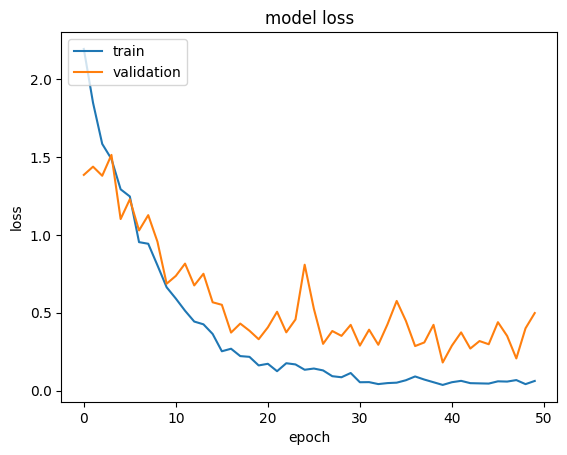

In [33]:
callbacks = [
    keras.callbacks.ModelCheckpoint("UBC-OCEAN_{epoch}_2964.h5",
                                    monitor='val_loss',
                                    save_best_only=True
                                   ),
    keras.callbacks.EarlyStopping(monitor='val_loss', 
                                  verbose=1,
                                  patience=10, 
                                  mode='min',
                                  restore_best_weights=True)
]

EPOCHS = 50

with strategy.scope():
    model = build_model(num_classes=NUM_CLASSES)



hist = model.fit(ds_train, 
                 epochs=EPOCHS, 
                 callbacks=callbacks,
                 validation_data=ds_valid
                )

plot_hist(hist)

In [34]:
def cal_bal_acc(y_true, y_pred):
    
    bal_acc = balanced_accuracy_score(y_true,pred)
    cm = confusion_matrix(y_true, y_pred)
    cmd = ConfusionMatrixDisplay(cm, display_labels=encode.keys())
    cmd.plot()
    print("Balanced Accuracy: ", bal_acc)

21/21 [==============================] - 7s 112ms/step
Balanced Accuracy:  0.9462418300653596


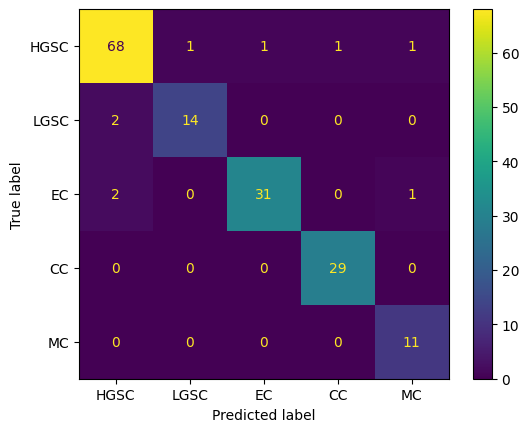

In [35]:
pred = model.predict(ds_valid)
pred = pred.argmax(axis=-1)
cal_bal_acc(y_valid, pred)

In [36]:
from sklearn.metrics import classification_report
class_report = classification_report(y_valid, pred)
print("\n Validation Classification Report:\n", class_report)


 Validation Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.94      0.94        72
           1       0.93      0.88      0.90        16
           2       0.97      0.91      0.94        34
           3       0.97      1.00      0.98        29
           4       0.85      1.00      0.92        11

    accuracy                           0.94       162
   macro avg       0.93      0.95      0.94       162
weighted avg       0.95      0.94      0.94       162



*Loading test data*****

In [37]:
test_data = pd.read_csv('../input/UBC-OCEAN/test.csv')
test_data

,image_id,image_width,image_height
0,41,28469,16987


In [38]:
test_thumbnails_folder_path = '../input/UBC-OCEAN/test_thumbnails'
test_data['full_path'] = test_data['image_id'].apply(lambda x: os.path.join(test_thumbnails_folder_path, f"{x}_thumbnail.png"))

In [43]:
from PIL import Image
import numpy as np

x_test = np.empty(shape=(len(test_data), 600, 600, 3), dtype=np.uint8)

for index, full_path in enumerate(test_data['full_path']):
    image_array = Image.open(full_path).resize((600, 600)).convert('RGB')
    x_test[index] = image_array

print(x_test.shape)

(1, 600, 600, 3)


In [44]:
from keras.models import load_model


model.load_weights('/kaggle/working/UBC-OCEAN_40_2964.h5')
predictions = model.predict(x_test)

predictions

1/1 [==============================] - 5s 5s/step


array([[9.9995375e-01, 2.1262076e-05, 2.2400482e-07, 5.2175324e-08,
        2.4753565e-05]], dtype=float32)

In [45]:
test_data['label'] = predictions.argmax(axis=1)  # Assuming one-hot encoding, get the index of the max value
submission_df = test_data[['image_id', 'label']]

In [47]:
label_mapping = {'CC': 0, 'EC': 1, 'HGSC': 2, 'LGSC': 3, 'MC': 4}
reverse_label_mapping = {v: k for k, v in label_mapping.items()}

# Map numerical labels to actual labels
submission_df.loc[:, 'label'] = submission_df['label'].map(reverse_label_mapping)

submission_df

,image_id,label
0,41,CC


In [48]:
# Save to CSV
submission_df.to_csv('submission.csv', index=False)